## Beginning

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import pickle
from scipy.stats import binned_statistic_2d, binned_statistic, binned_statistic_dd
import h5py
from h5py import File
import matplotlib.patches as patches
from matplotlib.patches import Ellipse
from matplotlib.patches import Rectangle
from PIL import Image

col = plt.rcParams['axes.prop_cycle'].by_key()['color']

# %matplotlib
import time
import warnings
from scipy import ndimage
import matplotlib.transforms as transforms
from scipy.fftpack import fft,ifft,fft2,ifft2,fftshift,fftfreq
from mpl_toolkits.axes_grid1 import Divider, Size  

nm = 10**(-9); um = 10**(-6); mm = 10**(-3);

## Defs

In [3]:
def NormalizeData(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

def confidence_ellipse(x, y, ax, n_std=3.0, facecolor='none', edgecolor='none', **kwargs):
    """
    Create a plot of the covariance confidence ellipse of *x* and *y*.

    Parameters
    ----------
    x, y : array-like, shape (n, )
        Input data.

    ax : matplotlib.axes.Axes
        The axes object to draw the ellipse into.

    n_std : float
        The number of standard deviations to determine the ellipse's radiuses.

    **kwargs
        Forwarded to `~matplotlib.patches.Ellipse`

    Returns
    -------
    matplotlib.patches.Ellipse
    """
    if x.size != y.size:
        raise ValueError("x and y must be the same size")

    cov = np.cov(x, y)
    pearson = cov[0, 1]/np.sqrt(cov[0, 0] * cov[1, 1])
    # Using a special case to obtain the eigenvalues of this two-dimensional dataset.
    ell_radius_x = np.sqrt(1 + pearson)
    ell_radius_y = np.sqrt(1 - pearson)
    ellipse = Ellipse((0, 0), width=ell_radius_x * 2, height=ell_radius_y * 2,
                      facecolor=facecolor, edgecolor=edgecolor, **kwargs)

    # Calculating the standard deviation of x from
    # the squareroot of the variance and multiplying
    # with the given number of standard deviations.
    scale_x = np.sqrt(cov[0, 0]) * n_std
    mean_x = np.mean(x)

    # calculating the standard deviation of y ...
    scale_y = np.sqrt(cov[1, 1]) * n_std
    mean_y = np.mean(y)

    transf = transforms.Affine2D() \
        .rotate_deg(45) \
        .scale(scale_x, scale_y) \
        .translate(mean_x, mean_y)

    ellipse.set_transform(transf + ax.transData)
    return ax.add_patch(ellipse)

In [6]:
def PlotData(n,m,array):
    
    start_time = time.time()

    avgE2 = np.array(f['avgE2']);
    gratings = np.array(f['zgrating'])/1000;
    counts = f['counts'];
    error = 0*gratings;
    roi = 'ROI_i%d_j%d' % (aa,cc)

    Data_norm = f[roi+'/data']
    Data_std = f[roi+'/std']
    Data_error = f[roi+'/error']

    new_avgE2 = avgE2[n:-m];

    X, Y = np.meshgrid(gratings, avgE2)
    cmap = plt.get_cmap('jet')

    figlen1 = bb - aa; figlen2 = dd - cc;
    if 1 in array:
        fig, ax = plt.subplots(figlen1, figlen2, sharex=False, sharey=False, figsize=(2*1920/96, 2*1080/96), dpi=96)
    if 2 in array:
        fig, bx = plt.subplots(figlen1, figlen2, sharex=False, sharey=False, figsize=(2*1920/96, 2*1080/96), dpi=96)
    if 3 in array:
        fig, cx = plt.subplots(figlen1, figlen2, sharex=False, sharey=False, figsize=(2*1920/96, 2*1080/96), dpi=96)
    if 4 in array:
        fig, dx = plt.subplots(figlen1, figlen2, sharex=False, sharey=False, figsize=(2*1920/96, 2*1080/96), dpi=96)
    if 5 in array:
        fig, ex = plt.subplots(figlen1, figlen2, sharex=False, sharey=False, figsize=(2*1920/96, 2*1080/96), dpi=96)
    if 6 in array:
        fig, fx = plt.subplots(figlen1, figlen2, sharex=False, sharey=False, figsize=(2*1920/96, 2*1080/96), dpi=96)

    for ii in range(aa, bb):    
        for jj in range(cc, dd):

            roiNameNow = 'ROI_i%d' % ii
            roi = '%s_j%d'% (roiNameNow, jj)
            # if jj == cc:
            #     print('%d ' % (ii), sep=' ', end='', flush=True)

#             for j in range(len(avgE2)):
#                 for k in range (len(gratings)):

#                     Data_norm[j, k] = f[roi+'/data'][j, k]# / (avgE1[i])# * avgE2[j]**2)
#                     # Data_std[j, k] = f[roi+'/std'][j, k]# / (avgE1[i])# * avgE2[j]**2)
#                     Data_error[j, k] = f[roi+'/error'][j, k]# / (avgE1[i])# * avgE2[j]**2)

            Data_norm = f[roi+'/data']
            Data_error = f[roi+'/error']

            new_Data_norm = Data_norm[n:-m,:];
            new_Data_error = Data_error[n:-m,:];

            error = np.sqrt(np.nansum(np.array(Data_error)**2,axis=0))/len(new_avgE2)

            fft_ = fft(np.nanmean(new_Data_norm, axis=0));   N = len(fft_); timestep = abs(gratings[1]-gratings[0])

            fft_freq = fftfreq(N, d=timestep)[:N//2];
            fft_ = 2/N*(fft_[:N//2])

            if 1 in array:
                ax[bb - ii - 1, jj - cc].set_title('ROI_i%d_j%d' % (ii,jj));
                ax[bb - ii - 1, jj - cc].scatter(avgE2[:], np.nanmean(Data_norm[:,:],axis=1),alpha=.5)
                ax[bb - ii - 1, jj - cc].axvline(x=new_avgE2[0],color='k',alpha=.5); ax[bb - ii - 1, jj - cc].axvline(x=new_avgE2[-1],color='k',alpha=.5)
            if 2 in array:
                bx[bb - ii - 1, jj - cc].set_title('ROI_i%d_j%d' % (ii,jj));
                bx[bb - ii - 1, jj - cc].contourf(X, Y, Data_norm, levels=100, cmap=cmap, extend='both')
                bx[bb - ii - 1, jj - cc].axhline(y=new_avgE2[0],color='k',alpha=.5); bx[bb - ii - 1, jj - cc].axhline(y=new_avgE2[-1],color='k',alpha=.5)
            if 3 in array:
                cx[bb - ii - 1, jj - cc].set_title('ROI_i%d_j%d' % (ii,jj));
                cx[bb - ii - 1, jj - cc].plot(gratings, np.nanmean(new_Data_norm, axis=0))
                cx[bb - ii - 1, jj - cc].fill_between(gratings, np.nanmean(new_Data_norm, axis=0)-error,np.nanmean(new_Data_norm, axis=0)+error, color='b', alpha=0.25)
            if 4 in array:
                dx[bb - ii - 1, jj - cc].set_title('ROI_i%d_j%d' % (ii,jj));
                dx[bb - ii - 1, jj - cc].plot(fft_freq[1:], abs(fft_[1:]),'o-b',alpha=.75) # amplitude
            if 5 in array:
                ex[bb - ii - 1, jj - cc].set_title('ROI_i%d_j%d' % (ii,jj));
                ex[bb - ii - 1, jj - cc].plot(fft_freq[1:], np.angle(fft_[1:]),'o-r',alpha=.75) # phase
            if 6 in array:
                ex[bb - ii - 1, jj - cc].set_title('ROI_i%d_j%d' % (ii,jj));
                for i in range(int(len(new_avgE2)/5)):
                    fx[bb - ii - 1, jj - cc].plot(gratings, NormalizeData(np.nanmean(new_Data_norm[5*i:5*(i+1),:], axis=0)),label=str(5*i)+':'+str(5*(i+1)));
                    if bb - ii - 1 == 0 and jj - cc == 0:
                        fx[bb - ii - 1, jj - cc].legend(fontsize=5)
                    
    frame = plt.gca()
    frame.axes.xaxis.set_ticklabels([])
    frame.axes.yaxis.set_ticklabels([])

    elapsed_time = time.time() - start_time
    a, b = divmod(elapsed_time/60, 1)
    # print()
    # print(int(a), 'minutes', 'and', int(b*60), 'seconds elapsed')
    
def SaveData(n,m,scan,aa,cc):

    avgE2 = np.array(f['avgE2']);
    gratings = np.array(f['zgrating'])/1000;
    counts = f['counts'];
    data_norm = 0*gratings;
    error = 0*gratings;
    roi = 'ROI_i%d_j%d' % (aa,cc)

    Data_norm = f[roi+'/data']
    Data_std = f[roi+'/std']
    Data_error = f[roi+'/error']

    new_avgE2 = avgE2[n:-m];

    Data_norm = f[roi+'/data']
    Data_error = f[roi+'/error']

    new_Data_norm = Data_norm[n:-m,:];
    new_Data_error = Data_error[n:-m,:];

    data_norm = np.nanmean(new_Data_norm, axis=0)
    error = np.sqrt(np.nansum(np.array(Data_error)**2,axis=0))/len(new_avgE2)
    
    plt.title('ROI_i%d_j%d' % (aa,cc));
    plt.plot(gratings, data_norm)
    plt.fill_between(gratings, data_norm-error,data_norm+error, color='b', alpha=0.25)
    
    array1 = gratings
    array2 = data_norm
    array3 = error

    variable_to_ID_file = 3.

    file_name_str = 'Scan_'+scan+'_['+str(aa)+','+str(cc)+'].txt'.format(variable_to_ID_file)
    # Pick the delimiter you desire.  I prefer tab  '/t'
    np.savetxt(file_name_str, np.column_stack((array1, array2, array3)), delimiter=' ') 
    
def phase_grating(x,Amin,Amax,period,N,phase,n_points):
    
    # Define the parameters
    period = period  # Period of the grating
    num_periods = N  # Number of periods

    # Create the phase grating
    phase_grating = np.where(np.cos(2 * np.pi * x / period) > 0, Amax*np.exp(1j*phase), Amin)
    
    return phase_grating

In [8]:
fid_xtg = File('/Users/danny/Work/AXTG_v1/scans/scanXTG_38_r985155_r985159.h5', 'r')
fid_xrd = File('/Users/danny/Work/AXTG_v1/scans/binned_scanDIF_38_r985155_r985159.h5', 'r')

data_xtg = pd.DataFrame({k: fid_xtg[k][()] for k in fid_xtg.keys() if k != 'ROIS'})
data_xrd = pd.DataFrame({k: fid_xrd[k][()] for k in fid_xtg.keys() if k != 'ROIS'})

gratings = np.unique(data_xtg['ZGRATING'])
gratingsBins = np.array([[x - 2., x + 2.] for x in gratings]).flatten()

In [10]:
print('there are', fid_xtg['ROIS'].shape[0] / len(gratings),'shots per z point')

there are 10000.0 shots per z point


mean value (red line) is = 337953.6


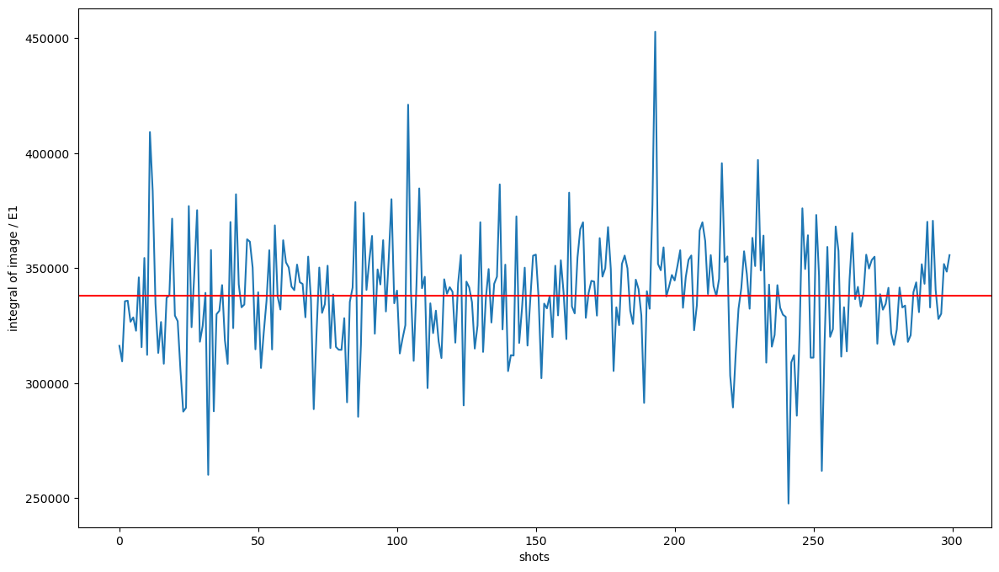

In [12]:
steps = int(300)

int_shots = np.zeros(int(300))
for k in range(steps):
            int_shots[k] = np.sum(fid_xtg['ROIS'][k,:,:])/fid_xtg['E1'][k]
        
plt.figure(figsize=(14, 8))
plt.plot(range(len(int_shots)), int_shots);
plt.axhline(y=np.nanmean(int_shots), color='r', linestyle='-')
plt.ylabel('integral of image / E1')
plt.xlabel('shots')

print('mean value (red line) is =', round(np.nanmean(int_shots),2))

In [14]:
pic_xtg = 0 * fid_xtg['ROIS'][0,:,:]
pic_xrd = 0 * fid_xrd['ROIS'][0,:,:]

n = 10000;

for k in range(0,n):
    pic_xtg += fid_xtg['ROIS'][k,:,:]
    pic_xrd += fid_xrd['ROIS'][k,:,:]
    
xtg_pic = pic_xtg - pic_xtg.min() + 0.1
xrd_pic = pic_xrd - pic_xrd.min() + 0.1

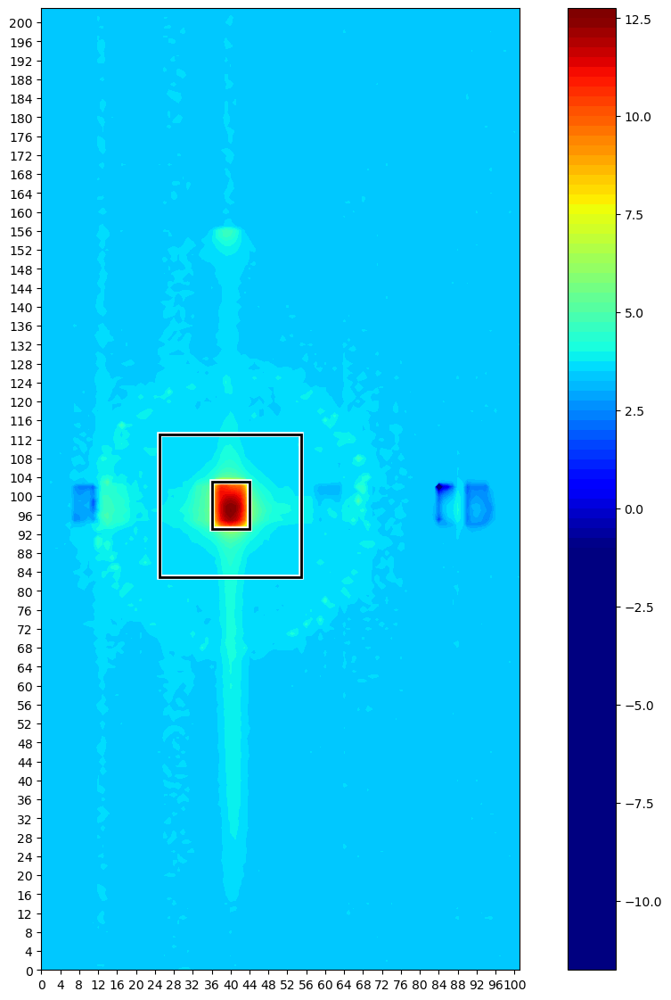

In [15]:
X, Y = np.meshgrid(range(np.shape(pic_xtg)[1]), range(np.shape(pic_xtg)[0]))

plt.figure(figsize=(14,14))
plt.gca().set_aspect('equal')
plt.contourf(X, Y, np.log(xtg_pic/len(range(0,n))), levels=100, cmap='jet', vmin=-1, vmax=12.5)
plt.colorbar()

# Get the current reference
ax = plt.gca()

rect = Rectangle((36,93),8,10,linewidth=4,edgecolor='w',facecolor='none')
rect2 = Rectangle((36,93),8,10,linewidth=2,edgecolor='k',facecolor='none')
ax.add_patch(rect)
ax.add_patch(rect2)

rect = Rectangle((25,83),30,30,linewidth=4,edgecolor='w',facecolor='none')
rect2 = Rectangle((25,83),30,30,linewidth=2,edgecolor='k',facecolor='none')
# ellipse = patches.Ellipse((58, 100), 5, 8, angle=0*45, linewidth=2, edgecolor='k', facecolor='none') # Add an ellipse on top of the image
# ax.add_patch(ellipse)
ax.add_patch(rect)
ax.add_patch(rect2)

# plt.axvline(x=53,lw=.5,color='k'); plt.axvline(x=63,lw=.5,color='k')

# rect = Rectangle((42,120),30,30,linewidth=4,edgecolor='w',facecolor='none')
# rect2 = Rectangle((42,120),30,30,linewidth=2,edgecolor='k',facecolor='none')
# ax.add_patch(rect)
# ax.add_patch(rect2)

ax.xaxis.set_major_locator(plt.MaxNLocator(30))
ax.yaxis.set_major_locator(plt.MaxNLocator(60))

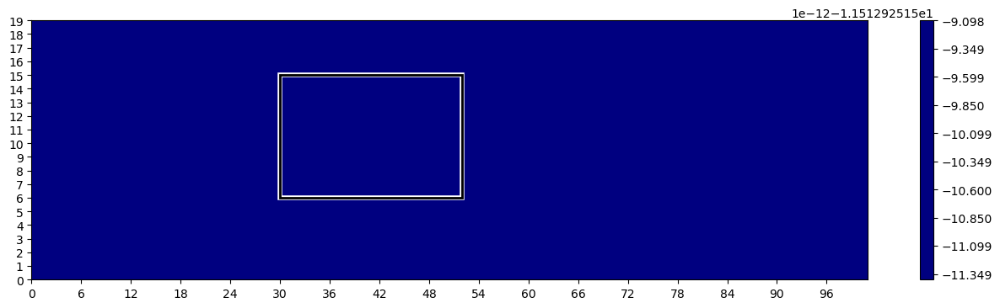

In [20]:
X, Y = np.meshgrid(range(np.shape(xrd_pic)[1]), range(np.shape(xrd_pic)[0]))

plt.figure(figsize=(16, 4))
plt.contourf(X, Y, np.log(xrd_pic/len(range(0,n))), levels=100, cmap='jet', vmin=-1, vmax=9.5)
plt.colorbar()

# Get the current reference
ax = plt.gca()

# rect = Rectangle((1,5),27,12,linewidth=4,edgecolor='w',facecolor='none')
# rect2 = Rectangle((1,5),27,12,linewidth=2,edgecolor='k',facecolor='none')
# ax.add_patch(rect)
# ax.add_patch(rect2)

rect = Rectangle((30,6),22,9,linewidth=4,edgecolor='w',facecolor='none')
rect2 = Rectangle((30,6),22,9,linewidth=2,edgecolor='k',facecolor='none')
ax.add_patch(rect)
ax.add_patch(rect2)

ax.xaxis.set_major_locator(plt.MaxNLocator(20))
ax.yaxis.set_major_locator(plt.MaxNLocator(20))

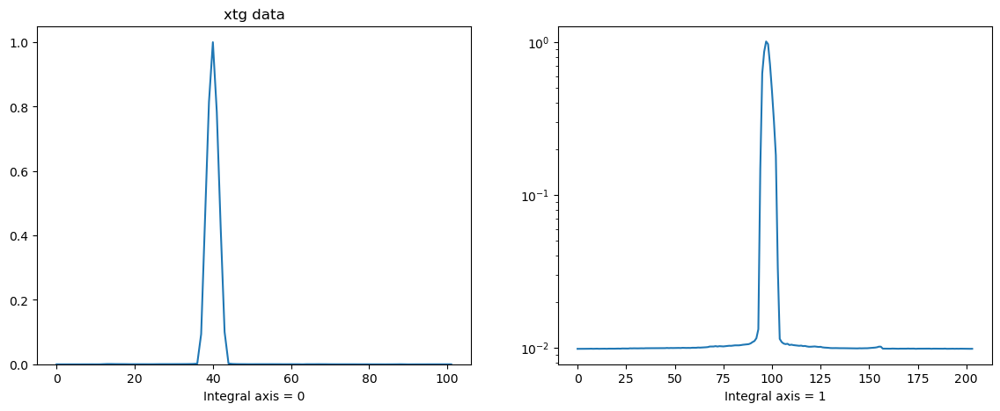

In [22]:
fig, ax = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(14, 5))

ax[0].set_title('xtg data')
ax[0].plot(np.nansum(pic_xtg, axis = 0)/np.max(np.nansum(pic_xtg, axis=0)))
ax[0].set_xlabel('Integral axis = 0');
ax[0].set_ylim(0,1.05); # ax[0].set_xlim(20,60);
# ax[0].set_yscale('log')

ax[1].plot(np.nansum(pic_xtg, axis = 1)/np.max(np.nansum(pic_xtg, axis=1))+0.01)
ax[1].set_xlabel('Integral axis = 1');
# ax[1].set_ylim(0,1.05); ax[1].set_xlim(25,175);
ax[1].set_yscale('log')

## Set constrains

In [24]:
data = data_xtg

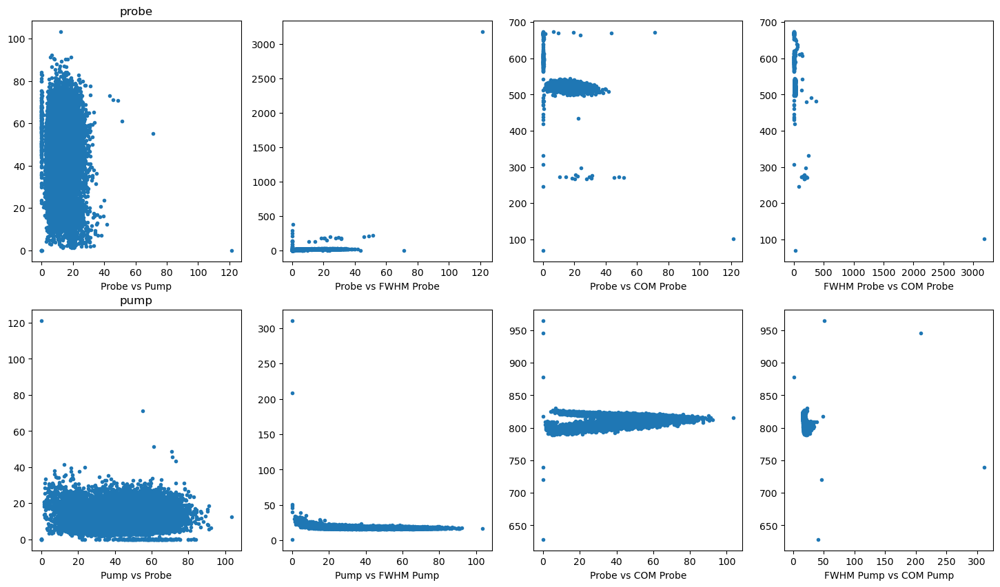

In [26]:
fig, ax = plt.subplots(2, 4, sharex=False, sharey=False, figsize=(18, 10))

ax[0,0].set_title('probe')
ax[0,0].plot(data['E1'],data['E2'], '.')
ax[0,0].set_xlabel('Probe vs Pump');

ax[0,1].plot(data['E1'],data['FWHM1'], '.')
ax[0,1].set_xlabel('Probe vs FWHM Probe');

ax[0,2].plot(data['E1'],data['X01'], '.')
ax[0,2].set_xlabel('Probe vs COM Probe');

ax[0,3].plot(data['FWHM1'],data['X01'], '.')
ax[0,3].set_xlabel('FWHM Probe vs COM Probe');

ax[1,0].set_title('pump')
ax[1,0].plot(data['E2'],data['E1'], '.')
ax[1,0].set_xlabel('Pump vs Probe');

ax[1,1].plot(data['E2'],data['FWHM2'], '.')
ax[1,1].set_xlabel('Pump vs FWHM Pump');

ax[1,2].plot(data['E2'],data['X02'], '.')
ax[1,2].set_xlabel('Probe vs COM Probe');

ax[1,3].plot(data['FWHM2'],data['X02'], '.')
ax[1,3].set_xlabel('FWHM Pump vs COM Pump');

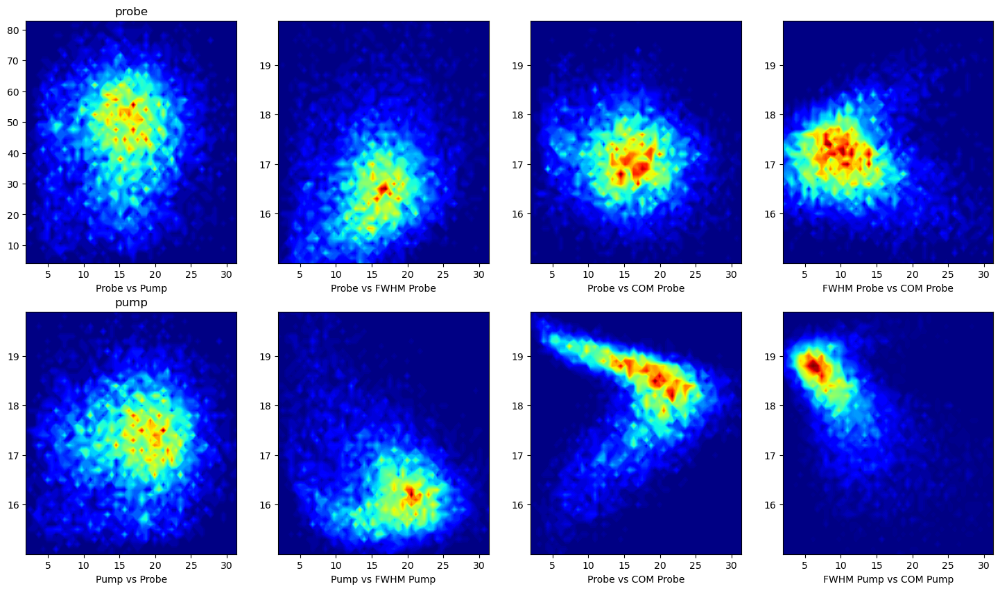

In [28]:
E1_min = 0; E1_max = 32
E2_min = 0; E2_max = 85
FWHM1_min = 15; FWHM1_max = 20
FWHM2_min = 16; FWHM2_max = 22
X01_min = 505; X01_max = 545
X02_min = 790; X02_max = 828

FWHM1 = [FWHM1_min, FWHM1_max]
FWHM2 = [FWHM2_min, FWHM2_max]
X01   = [X01_min, X01_max]
X02   = [X02_min, X02_max]
E1    = [E1_min, E1_max]
E2    = [E2_min, E2_max]

NE1bins = 1*(E1_max-E1_min) + 1 #Probe
NE2bins = 1*(E2_max-E2_min) + 1 #Pump

filterID = np.ones(len(data), dtype='bool')
# Filters
filterID = np.logical_and(filterID, np.logical_and(data['FWHM1'] >= min(FWHM1), data['FWHM1'] <= max(FWHM1)))
filterID = np.logical_and(filterID, np.logical_and(data['FWHM2'] >= min(FWHM2), data['FWHM2'] <= max(FWHM2))) 
filterID = np.logical_and(filterID, np.logical_and(data['X01'] >= min(X01), data['X01'] <= max(X01)))
filterID = np.logical_and(filterID, np.logical_and(data['X02'] >= min(X02), data['X02'] <= max(X02)))
filterID = np.logical_and(filterID, np.logical_and(data['E1'] >= min(E1), data['E1'] <= max(E1)))
filterID = np.logical_and(filterID, np.logical_and(data['E2'] >= min(E2), data['E2'] <= max(E2)))

data_ = data[filterID]

fig, ax = plt.subplots(2, 4, sharex=False, sharey=False, figsize=(18, 10))

counts, bins_x, bins_y = np.histogram2d(data_['E1'], data_['E2'], bins=(50, 50))
X, Y = np.meshgrid(bins_x[:-1], bins_y[:-1])
ax[0,0].set_title('probe')
ax[0,0].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[0,0].set_xlabel('Probe vs Pump');

counts, bins_x, bins_y = np.histogram2d(data_['E1'],data_['FWHM1'], bins=(50, 50))
X, Y = np.meshgrid(bins_x[:-1], bins_y[:-1])
ax[0,1].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[0,1].set_xlabel('Probe vs FWHM Probe');

counts, bins_x, bins_y = np.histogram2d(data_['E1'],data_['X01'], bins=(50, 50))
ax[0,2].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[0,2].set_xlabel('Probe vs COM Probe');

counts, bins_x, bins_y = np.histogram2d(data_['FWHM1'],data_['X01'], bins=(50, 50))
ax[0,3].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[0,3].set_xlabel('FWHM Probe vs COM Probe');

ax[1,0].set_title('pump')
counts, bins_x, bins_y = np.histogram2d(data_['E2'], data_['E1'], bins=(50, 50))
ax[1,0].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[1,0].set_xlabel('Pump vs Probe');

counts, bins_x, bins_y = np.histogram2d(data_['E2'],data_['FWHM2'], bins=(50, 50))
ax[1,1].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[1,1].set_xlabel('Pump vs FWHM Pump');

counts, bins_x, bins_y = np.histogram2d(data_['E2'],data_['X02'], bins=(50, 50))
ax[1,2].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[1,2].set_xlabel('Probe vs COM Probe');

counts, bins_x, bins_y = np.histogram2d(data_['FWHM2'],data_['X02'], bins=(50, 50))
ax[1,3].contourf(X, Y, counts.T, levels=120, cmap='jet')
ax[1,3].set_xlabel('FWHM Pump vs COM Pump');

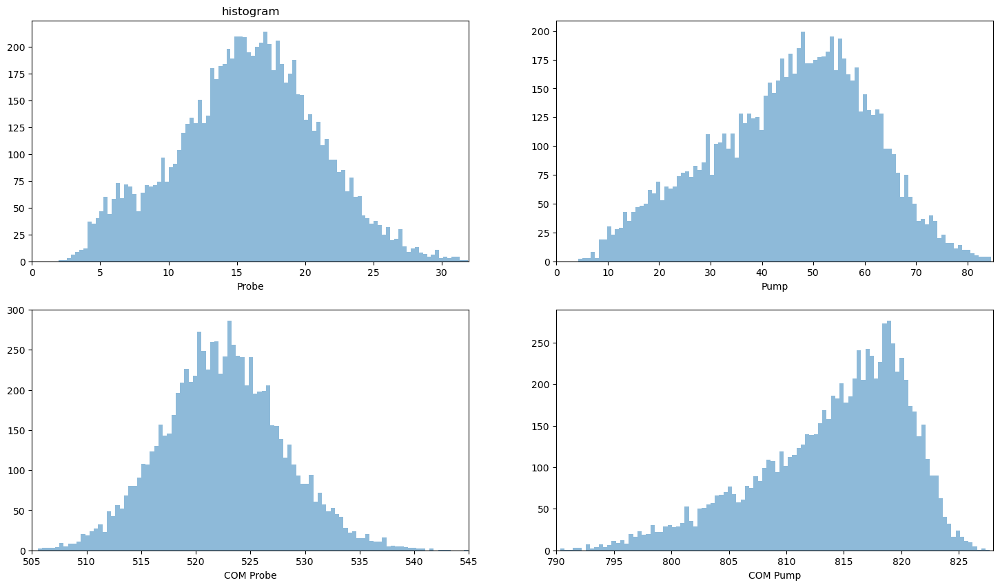

In [30]:
fig, ax = plt.subplots(2, 2, sharex=False, sharey=False, figsize=(18, 10))

ax[0,0].set_title('histogram')
ax[0,0].hist(data_['E1'], bins=100, alpha=.5);
ax[0,0].set_xlim(E1_min,E1_max)
ax[0,0].set_xlabel('Probe');

ax[0,1].hist(data_['E2'], bins=100, alpha=.5);
ax[0,1].set_xlim(E2_min,E2_max)
ax[0,1].set_xlabel('Pump');

ax[1,0].hist(data_['X01'], bins=100, alpha=.5);
ax[1,0].set_xlim(X01_min,X01_max)
ax[1,0].set_xlabel('COM Probe');

ax[1,1].hist(data_['X02'], bins=100, alpha=.5);
ax[1,1].set_xlim(X02_min,X02_max)
ax[1,1].set_xlabel('COM Pump');

In [32]:
data_xtg['s'] = np.sum(fid_xtg['ROIS'], axis=(1, 2))

the signal depends on the probe as y = 303078.38 * x + 483932.53


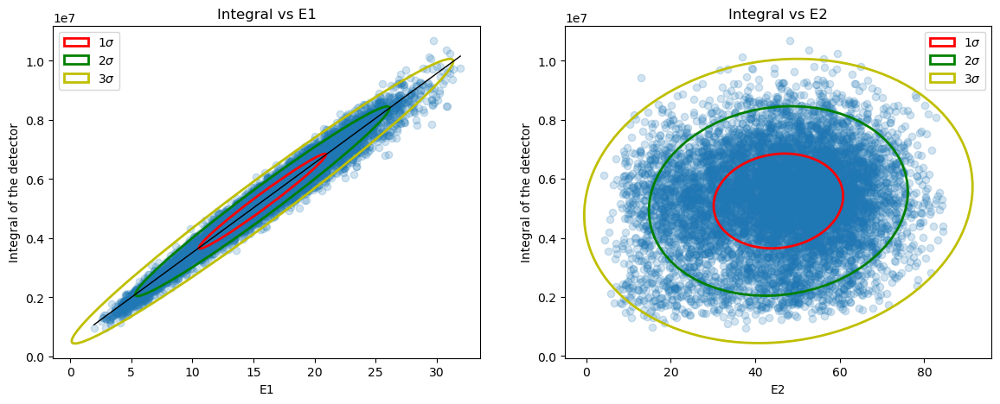

In [33]:
fig = plt.figure(figsize=(14,5))
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);

x = data_xtg['E1'][filterID]
y = data_xtg['s'][filterID]
p = np.poly1d(np.polyfit(x, y, 1))

ax1.set_title('Integral vs E1')
ax1.scatter(x,y,alpha=.2)
confidence_ellipse(x, y, ax1, n_std = 1,label=r'$1\sigma$',facecolor='none',edgecolor='r',lw=2)
confidence_ellipse(x, y, ax1, n_std = 2,label=r'$2\sigma$', facecolor='none',edgecolor='g',lw=2)
confidence_ellipse(x, y, ax1, n_std = 3,label=r'$3\sigma$', facecolor='none',edgecolor='y',lw=2)
ax1.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)),'-k', linewidth=1)
ax1.set_xlabel('E1'); ax1.set_ylabel('Integral of the detector')
ax1.legend()

x = data_xtg['E2'][filterID]

ax2.set_title('Integral vs E2')
ax2.scatter(x,y,alpha=.2)
confidence_ellipse(x,y,ax2,n_std = 1,label=r'$1\sigma$',facecolor='none',edgecolor='r',lw=2)
confidence_ellipse(x,y,ax2, n_std = 2,label=r'$2\sigma$', facecolor='none',edgecolor='g',lw=2)
confidence_ellipse(x,y,ax2, n_std = 3,label=r'$3\sigma$', facecolor='none',edgecolor='y',lw=2)
ax2.set_xlabel('E2'); ax2.set_ylabel('Integral of the detector')
ax2.legend()

print('the signal depends on the probe as y =', round(p[1],2), '* x +',round(p[0],2))

In [108]:
data_xrd['s'] = np.sum(fid_xrd['ROIS'], axis=(1, 2))

the signal depends on the probe as y = 1940.13 * x + -508.21


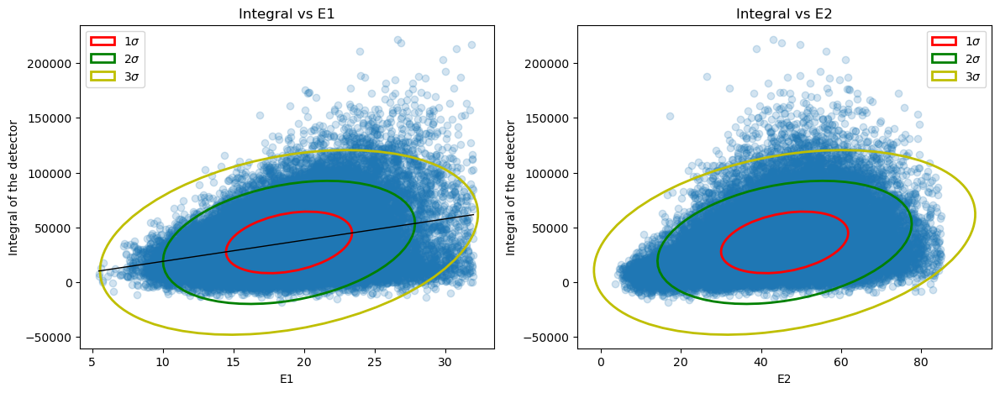

In [112]:
fig = plt.figure(figsize=(14,5))
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);

x = data_xtg['E1'][filterID]
y = data_xrd['s'][filterID]
p = np.poly1d(np.polyfit(x, y, 1))

ax1.set_title('Integral vs E1')
ax1.scatter(x,y,alpha=.2)
confidence_ellipse(x, y, ax1, n_std = 1,label=r'$1\sigma$',facecolor='none',edgecolor='r',lw=2)
confidence_ellipse(x, y, ax1, n_std = 2,label=r'$2\sigma$', facecolor='none',edgecolor='g',lw=2)
confidence_ellipse(x, y, ax1, n_std = 3,label=r'$3\sigma$', facecolor='none',edgecolor='y',lw=2)
ax1.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)),'-k', linewidth=1)
ax1.set_xlabel('E1'); ax1.set_ylabel('Integral of the detector')
ax1.legend()

x = data_xtg['E2'][filterID]

ax2.set_title('Integral vs E2')
ax2.scatter(x,y,alpha=.2)
confidence_ellipse(x,y,ax2,n_std = 1,label=r'$1\sigma$',facecolor='none',edgecolor='r',lw=2)
confidence_ellipse(x,y,ax2, n_std = 2,label=r'$2\sigma$', facecolor='none',edgecolor='g',lw=2)
confidence_ellipse(x,y,ax2, n_std = 3,label=r'$3\sigma$', facecolor='none',edgecolor='y',lw=2)
ax2.set_xlabel('E2'); ax2.set_ylabel('Integral of the detector')
ax2.legend()

print('the signal depends on the probe as y =', round(p[1],2), '* x +',round(p[0],2))

## Data reduction

In [44]:
# start_time = time.time()

# dataBinned = {}; dataBinned_std = {};

# fid = fid_xtg # fid_dif or fid_xtg

# # roi_xtg --------------------------------------

# # roi_0 = [53,83,24,56] # top rectangle
# roi_0 = [96,98,41,49] # middle rectangle (24,83),32,30
# # roi_0 = [113,143,24,56] # bottom rectangle

# # roi_dif --------------------------------------

# # roi_0 = [1,19,1,28] # left rectangle
# # roi_0 = [1,19,28,55] # right rectangle

# # ----------------------------------------------

# aa = roi_0[0]; bb = roi_0[1]; cc = roi_0[2]; dd = roi_0[3]

# for i in range(aa, bb):
#     for j in range(cc, dd):
#         roiNameNow = 'ROI_i%d_j%d' % (i, j)
#         if j == cc:
#             roiNameNow2 = '%d ' % (i)
#             print(roiNameNow2, sep=' ', end='', flush=True)
        
#         data['inUseROI'] = fid['ROIS'][:, i, j]
        
#         dataFiltered = data[filterID]

#         # binns = binned_statistic_dd((dataFiltered['E1'], dataFiltered['E2'], dataFiltered['ZGRATING']), 
#         #                             dataFiltered['inUseROI'] , statistic=np.nanmean, 
#         #                             bins=(NE1bins, NE2bins, gratingsBins)) # len(gratings)
        
#         binns = binned_statistic_dd((dataFiltered['E2'], dataFiltered['ZGRATING']), 
#                                     dataFiltered['inUseROI']/dataFiltered['E1'] , statistic=np.nanmean, 
#                                     bins=(NE2bins, gratingsBins)) # len(gratings)
        
#         dataBinned[roiNameNow] = binns.statistic[:, ::2].copy()
        
#         binns_std = binned_statistic_dd((dataFiltered['E2'], dataFiltered['ZGRATING']), 
#                                     dataFiltered['inUseROI']/dataFiltered['E1'] , statistic=np.nanstd, 
#                                     bins=(NE2bins, gratingsBins)) # len(gratings)
        
#         dataBinned_std[roiNameNow] = binns_std.statistic[:, ::2].copy()
        
#         borders = binns.bin_edges

# # avgE1 = borders[0][:-1] + np.diff(borders[0])/2
# avgE2 = borders[0][:-1] + np.diff(borders[0])/2
# avgGR = borders[1][:-1]

# elapsed_time = time.time() - start_time
# a, b = divmod(elapsed_time/60, 1)
# print()
# print(int(a), 'minutes', 'and', int(b*60), 'seconds elapsed')

## Save files

In [46]:
# which_scan = 'scan_30_XTG'
# which_roi = '[83,113,24,56]'

# with open(which_scan+'_dataBinned_roi_'+which_roi+'.pkl', 'wb') as f:
#     pickle.dump(dataBinned, f)
# with open(which_scan+'_dataBinned_std_roi_'+which_roi+'.pkl', 'wb') as f:
#     pickle.dump(dataBinned_std, f)
# # with open(which_scan+'_avgE1_roi_'+which_roi+'.pkl', 'wb') as f:
# #     pickle.dump(avgE1, f)
# with open(which_scan+'_avgE2_roi_'+which_roi+'.pkl', 'wb') as f:
#     pickle.dump(avgE2, f)

## Load files

In [48]:
# roi_0 = [96,98,41,49] # left rectangle [88,108,24,56]
# aa = roi_0[0]; bb = roi_0[1]; cc = roi_0[2]; dd = roi_0[3]

In [49]:
# which_scan = 'scan_30_XTG'
# which_roi = '[83,113,24,56]'

# with open(which_scan+'_dataBinned_roi_'+which_roi+'.pkl', 'rb') as f:
#     dataBinned_ = pickle.load(f)
# with open(which_scan+'_dataBinned_std_roi_'+which_roi+'.pkl', 'rb') as f:
#     dataBinned_std_ = pickle.load(f)
# # with open(which_scan+'_avgE1_roi_'+which_roi+'.pkl', 'rb') as f:
# #     avgE1 = pickle.load(f)
# with open(which_scan+'_avgE2_roi_'+which_roi+'.pkl', 'rb') as f:
#     avgE2 = pickle.load(f)

In [50]:
# path = 'C:/Users/Den/Work/Python_scripts/Actual_Work/AXTG_SACLA_2021/'

# talbot_2_8_mm_pump_x, talbot_2_8_mm_pump_y = np.loadtxt(path+'Den_talbot_5_8_mm_pump.txt', skiprows=0).T
# talbot_2_8_mm_probe_x, talbot_2_8_mm_probe_y = np.loadtxt(path+'Den_talbot_5_8_mm_probe.txt', skiprows=0).T

# talbot_7_7p5_mm_pump_x, talbot_7_7p5_mm_pump_y = np.loadtxt(path+'Den_talbot_7_7p5_mm_pump.txt', skiprows=0).T
# talbot_7_7p5_mm_probe_x, talbot_7_7p5_mm_probe_y = np.loadtxt(path+'Den_talbot_7_7p5_mm_probe.txt', skiprows=0).T

----------------------------------------------------------

In [52]:
# warnings.filterwarnings("ignore", message="divide by zero encountered in true_divide")
# warnings.filterwarnings("ignore", message="Mean of empty slice")
# warnings.filterwarnings("ignore", message="Degrees of freedom <= 0 for slice")
# warnings.filterwarnings("ignore", message="invalid value encountered in sqrt")

## New data visualization

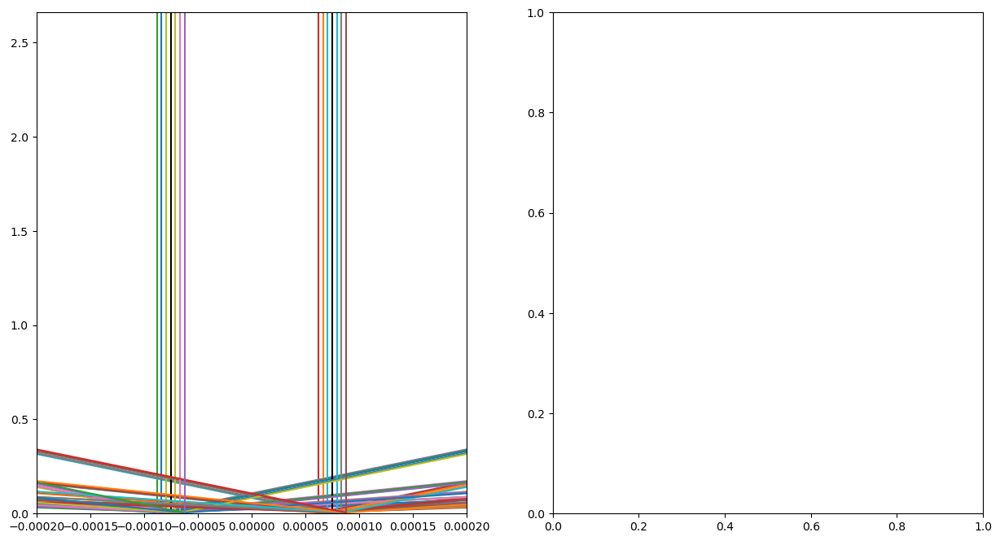

In [76]:
λ = 0.171*nm
period = 200*nm
period_xtg = 200*nm
z = 5*mm
z_det = 2.66

fig = plt.figure(figsize=(15,8))
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);

for n in range(-3,4):
    sin_theta = n*λ/period;
    theta = np.arcsin(sin_theta)
    if n != 0:
        ipo = z/np.cos(theta)
        ipo_3 = z_det/np.cos(theta)
        ax1.plot((0-150/2*um,ipo_3*np.sin(theta)-150/2*um),(0,z_det))
        ax1.plot((0+150/2*um,ipo_3*np.sin(theta)+150/2*um),(0,z_det))

        for k in range(-3,4):
            sin_theta_2 = k*λ/period_xtg - np.sin(theta);
            theta_2 = np.arcsin(sin_theta_2)
            ipo_2 = z_det/np.cos(theta_2)
            ax1.plot((ipo*np.sin(theta)-150/2*um,ipo*np.sin(theta)+ipo_2*np.sin(theta_2)-150/2*um),(z,z_det))
            ax1.plot((ipo*np.sin(theta)+150/2*um,ipo*np.sin(theta)+ipo_2*np.sin(theta_2)+150/2*um),(z,z_det))
    else:
        ax1.plot((0-150/2*um,0-150/2*um),(0,z_det),c='k') # (x1,x2),(y1,y2)
        ax1.plot((0+150/2*um,0+150/2*um),(0,z_det),c='k') # (x1,x2),(y1,y2)

ax1.set_xlim([-200*um,200*um]);
ax1.set_ylim([0,z_det]);

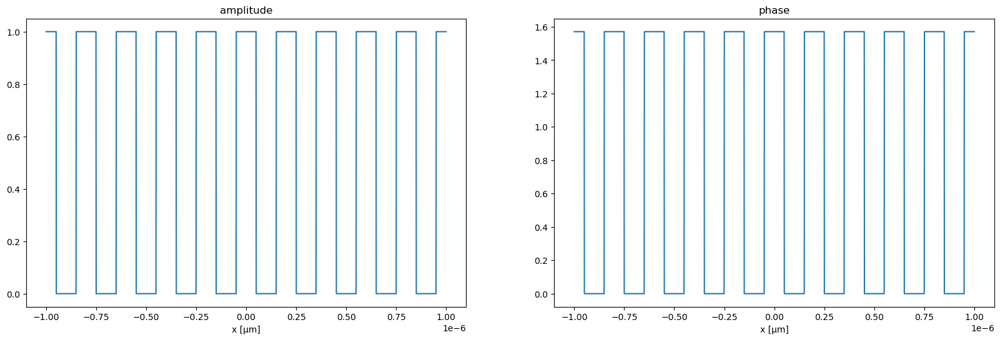

In [60]:
x = np.linspace(-1e-6, 1e-6, 2048)  # Spatial grid
grating = phase_grating(x,Amin=0,Amax=1,period=200*nm,N=50,phase=np.pi/2,n_points=5*2048)

fig = plt.figure(figsize=(20, 6))
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);

ax1.set_title('amplitude')
ax1.plot(x,abs(grating))
ax1.set_xlabel('x [μm]');

ax2.set_title('phase')
ax2.plot(x,np.angle(grating))
ax2.set_xlabel('x [μm]');

### XTG scan 30 [83,113,25,55]

In [203]:
roi_0 = [83,113,25,55]; aa,bb,cc,dd = roi_0[0],roi_0[1],roi_0[2],roi_0[3];

which_scan = 'scan_30_XTG'; which_roi = '['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']'

f = h5py.File(which_scan+'_'+which_roi+'.h5','r+'); 

In [120]:
roi = [91,96,53,63]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=10,array=[2,3,5])

roi = [96,101,53,63]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=10,array=[2,3,5])

roi = [101,106,53,63]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=10,array=[2,3,5])

roi = [106,111,53,63]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=10,array=[2,3,5])

roi = [111,116,53,63]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=10,array=[2,3,5])

roi = [116,121,53,63]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=10,array=[2,3,5])

### XTG scan 30 [93,103,36,44]

[93,103,36,44]


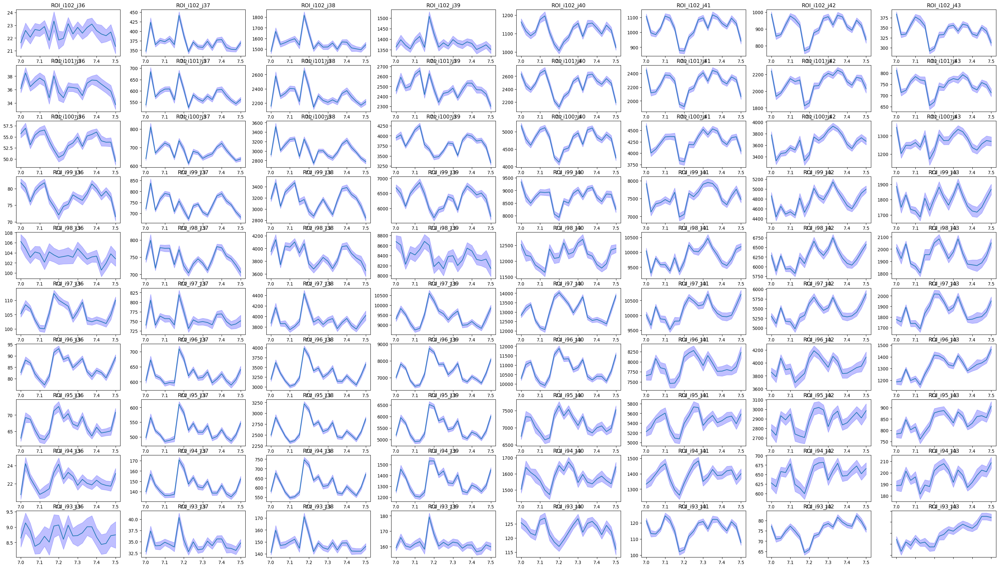

In [205]:
roi = [93,103,36,44]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=10,array=[3])

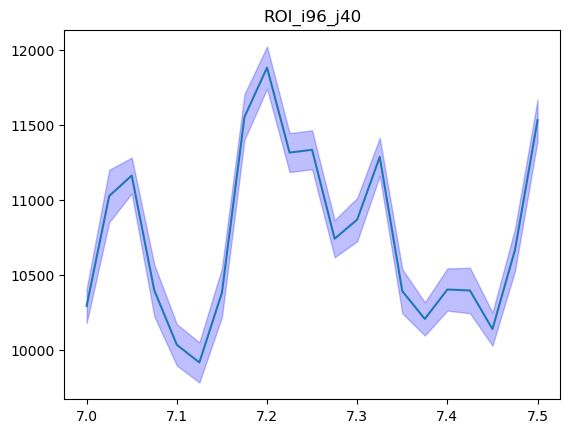

In [174]:
SaveData(n=5,m=10,scan='30',aa=96,cc=40)
# gratings,data_norm,error = np.loadtxt('Scan_30_[97,40].txt', skiprows=0).T

### XRD scan 30 [6,16,30,50]

In [118]:
roi = [6,16,30,50]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];

which_scan = 'scan_30_DIF'; which_roi = '['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']'

f = h5py.File(which_scan+'_'+which_roi+'.h5','r+'); 

[6,11,30,40]
[6,11,40,50]
[11,16,30,40]
[11,16,40,50]


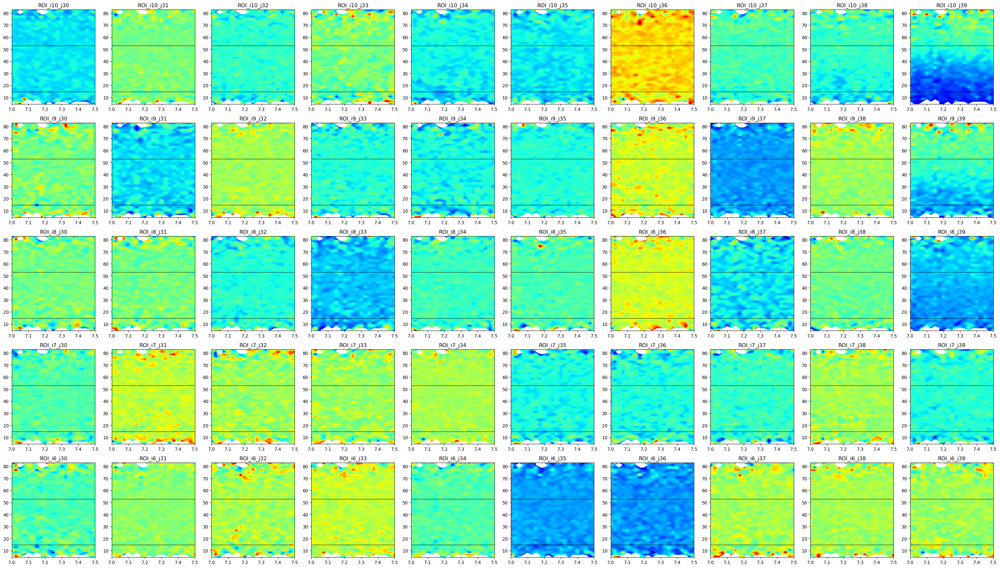

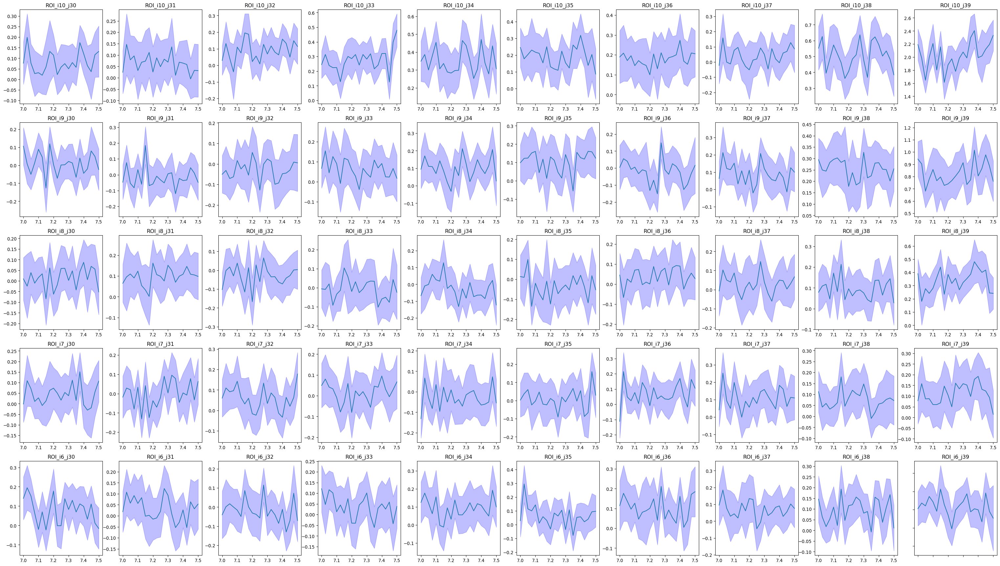

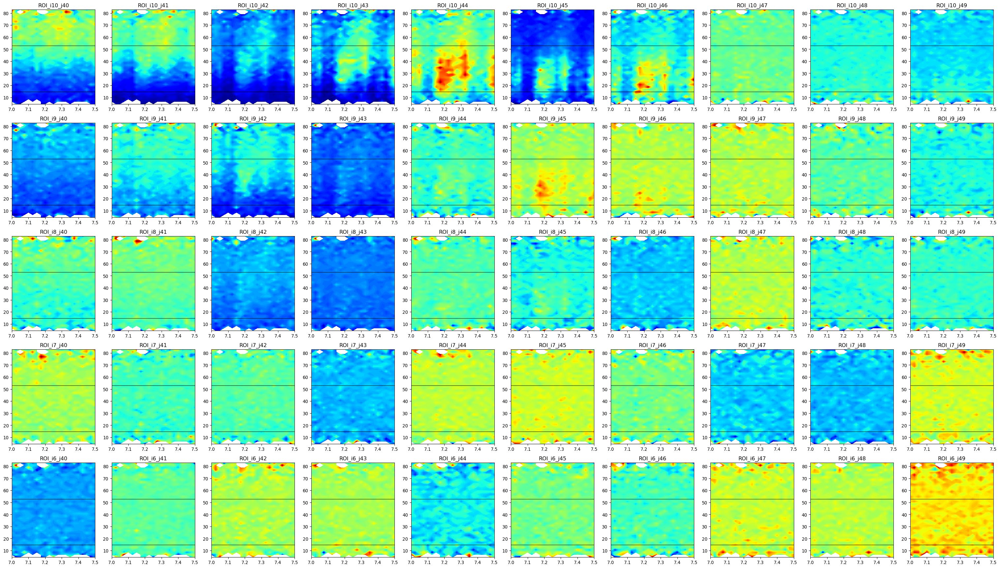

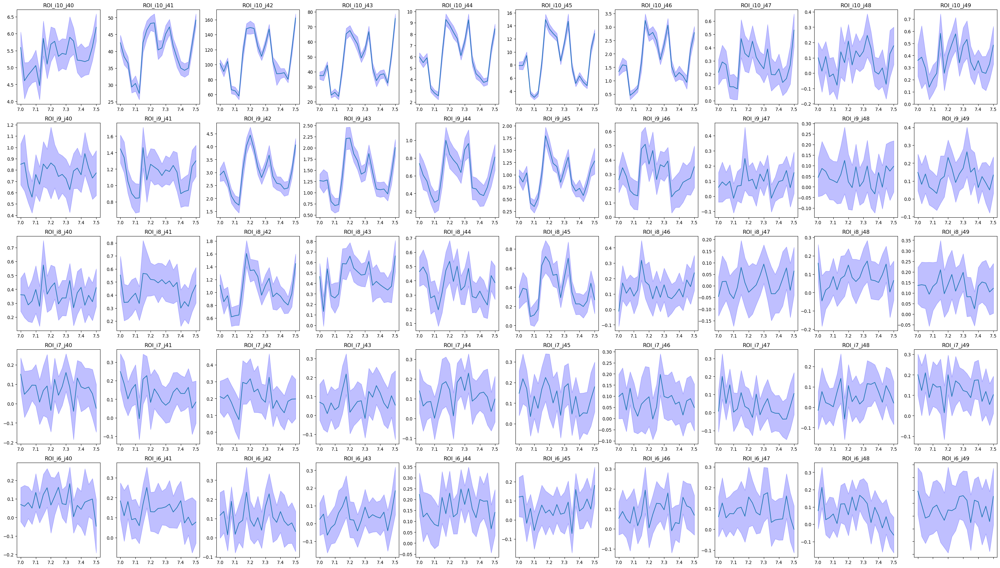

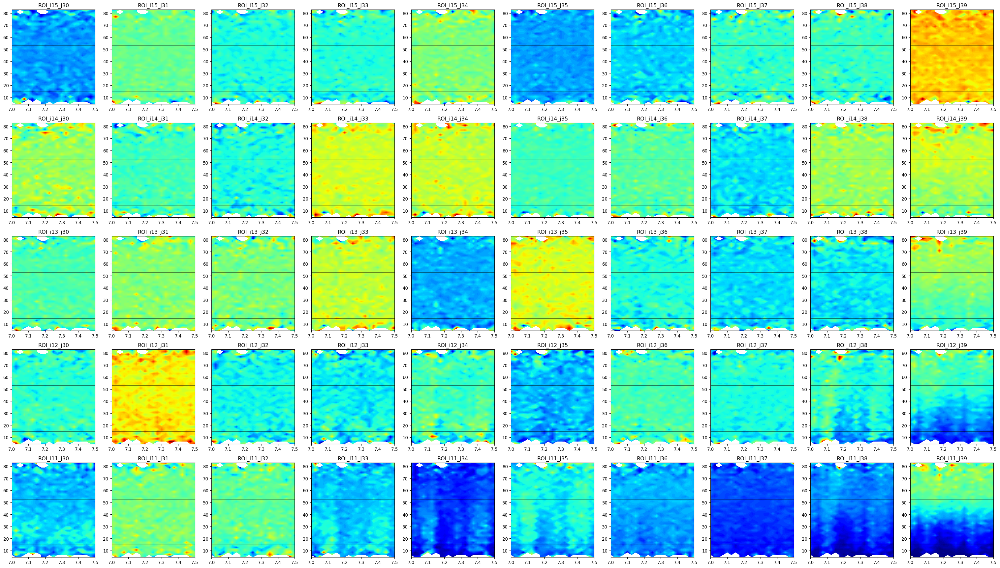

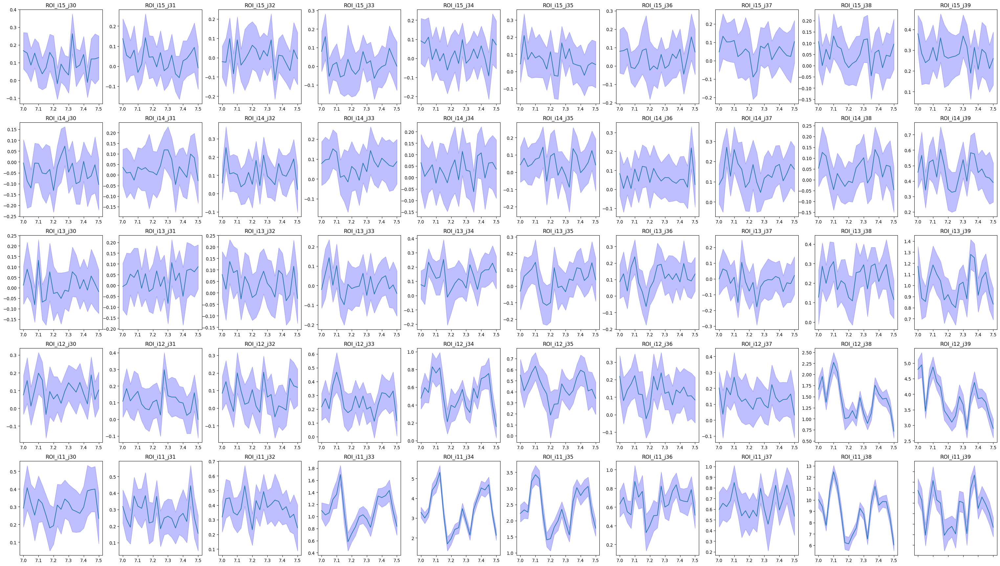

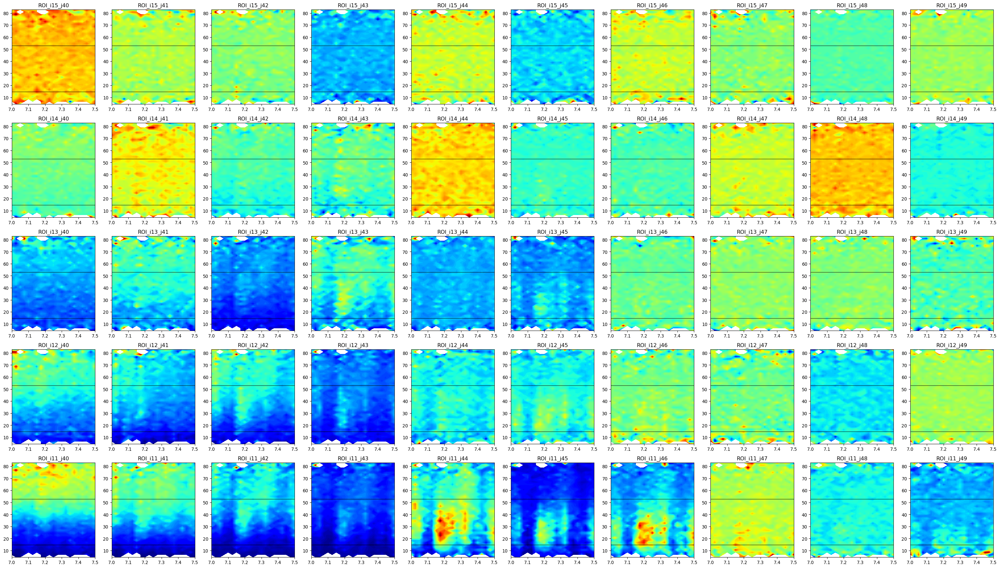

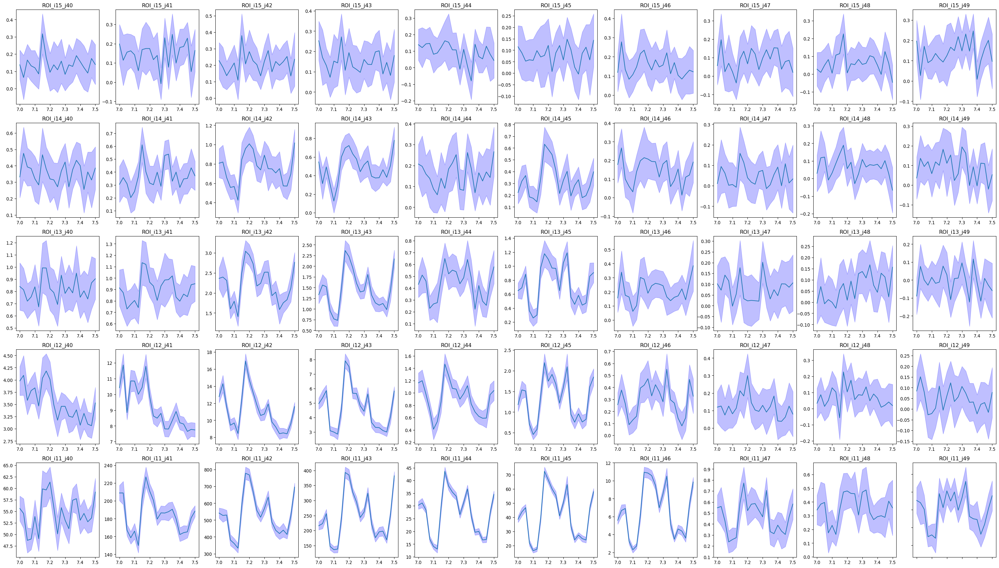

In [132]:
roi = [6,11,30,40]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=15,array=[2,3])

roi = [6,11,40,50]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=15,array=[2,3])

roi = [11,16,30,40]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=15,array=[2,3])

roi = [11,16,40,50]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=15,array=[2,3])

[9,13,40,50]


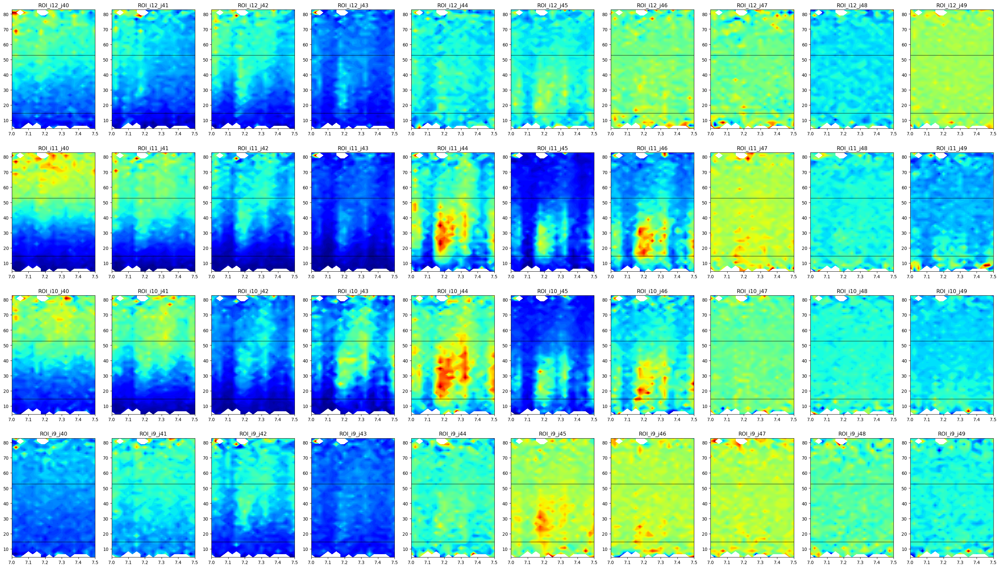

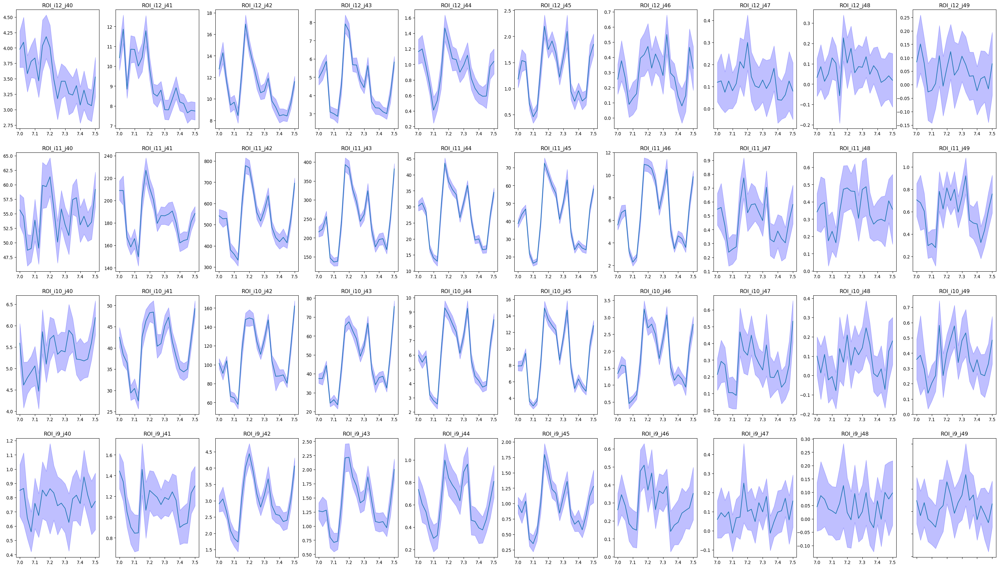

In [140]:
roi = [9,13,40,50]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=15,array=[2,3])

[10,12,41,46]


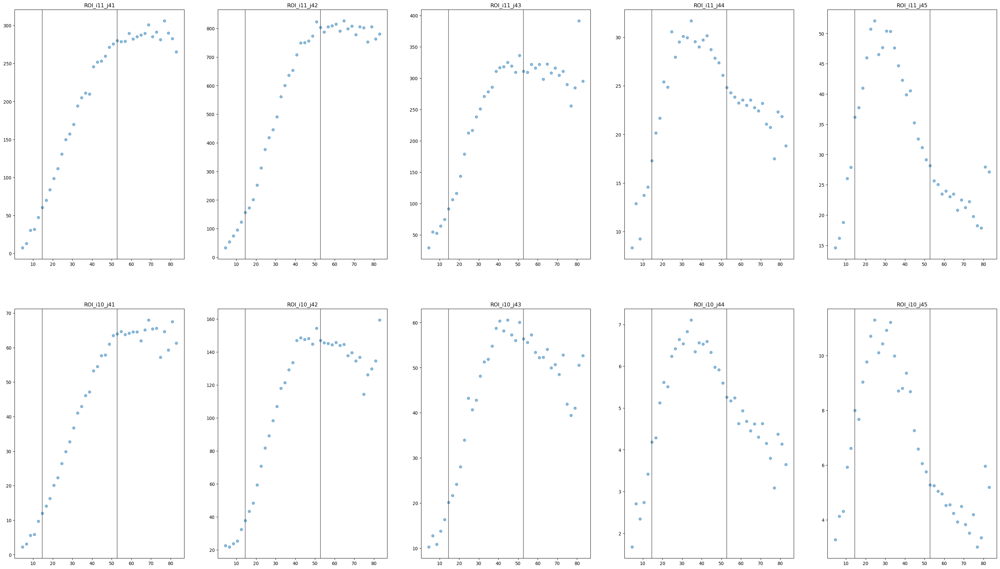

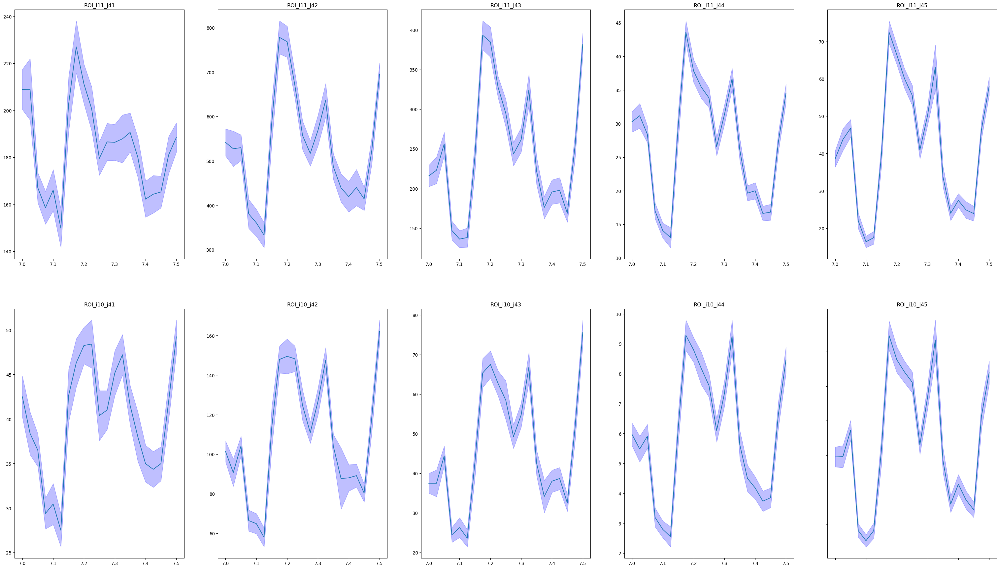

In [206]:
roi = [10,12,41,46]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];
print('['+str(aa)+','+str(bb)+','+str(cc)+','+str(dd)+']')
PlotData(n=5,m=15,array=[1,3])

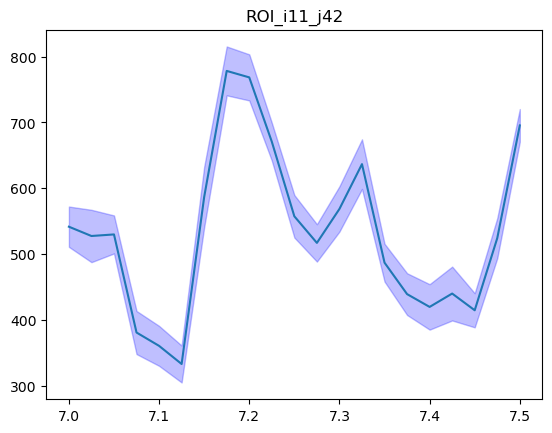

In [120]:
SaveData(n=5,m=15,scan='30',aa=11,cc=42)

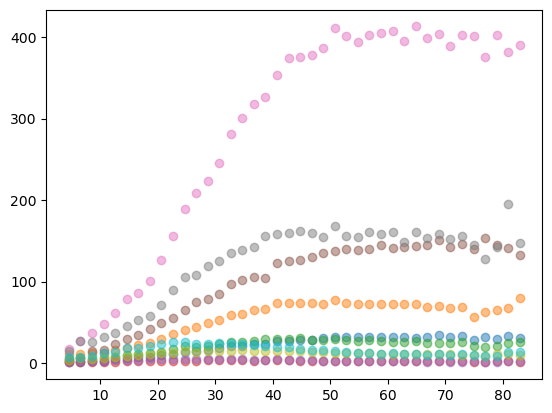

In [224]:
roi = [10,12,41,46]; aa,bb,cc,dd = roi[0],roi[1],roi[2],roi[3];

avgE2 = np.array(f['avgE2']);
gratings = np.array(f['zgrating'])/1000;
roi = 'ROI_i%d_j%d' % (aa,cc)

Data_norm = 0*np.array(f[roi+'/data'])
Data_norm_2 = 0*np.array(f[roi+'/data'])

for ii in range(aa, bb):    
    for jj in range(cc, dd):

        roiNameNow = 'ROI_i%d' % ii
        roi = '%s_j%d'% (roiNameNow, jj)

        Data_norm_2 = np.concatenate((Data_norm,np.array(f[roi+'/data'])),axis=1)

        plt.scatter(avgE2[:], np.nanmean(Data_norm_2[:,:],axis=1),alpha=.5)

## Data visualization

In [130]:
def extract2(data):
    x = np.zeros(len(data)); y = np.zeros(len(data));
    for i in range(0,len(data)):
        x[i] = data[i][0]; y[i] = data[i][1];
    return x,y

def extract3(data):
    x = np.zeros(len(data)); y = np.zeros(len(data)); err = np.zeros(len(data))
    for i in range(0,len(data)):
        x[i] = data[i][0]; y[i] = data[i][1]; err[i] = data[i][2]
    return x,y,err

### 25

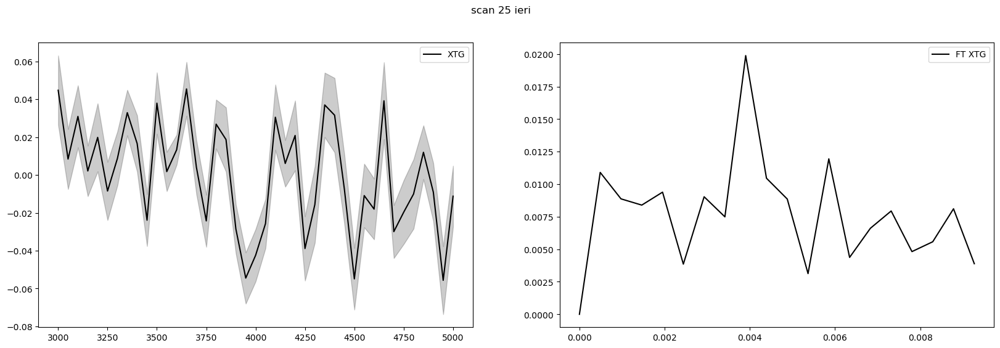

In [85]:
data = np.genfromtxt('Archive_Svetina/Tracce_AXTG_SACLA/Scan_25.txt', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
xtg_25 = extract3(data)

fft_ = fft(xtg_25[1]);   N = len(fft_); timestep = abs(xtg_25[0][1]-xtg_25[0][0])

fft_freq_xtg_25 = fftfreq(N, d=timestep)[:N//2];
fft_xtg_25 = abs(2/N*(fft_[:N//2]))

# print(timestep)
            
# data = np.genfromtxt('Archive_Svetina/S25_i10_EXP.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
# sim_25 = extract(data)

# fft_ = fft(sim_25[1]);   N = len(fft_); timestep = abs(sim_25[0][1]-sim_25[0][0])

# fft_freq_sim_25 = fftfreq(N, d=timestep)[:N//2];
# fft_sim_25 = abs(2/N*(fft_[:N//2]))

# print(timestep)

fig = plt.figure(figsize=(20, 6)); fig.suptitle('scan 25 ieri')
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);
    
ax1.plot(xtg_25[0],xtg_25[1],c='k',label='XTG');
ax1.fill_between(xtg_25[0],xtg_25[1]-xtg_25[2],xtg_25[1]+xtg_25[2],color='k',alpha=.2);
# ax1.plot(sim_25[0],sim_25[1],c='r',label='sim');
ax1.legend();

ax2.plot(fft_freq_xtg_25[:],fft_xtg_25[:],c='k',label='FT XTG');
# ax2.plot(fft_freq_sim_25[:],fft_sim_25[:],c='r',label='FT sim');
ax2.legend();

50.0
26.002165999999306


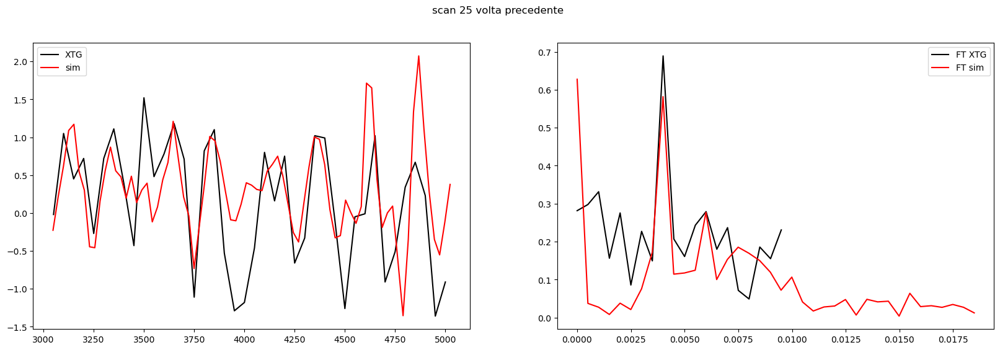

In [73]:
data = np.genfromtxt('Archive_Svetina/S25_i10_EXP.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
xtg_25 = extract(data)

fft_ = fft(xtg_25[1]);   N = len(fft_); timestep = abs(xtg_25[0][1]-xtg_25[0][0])

fft_freq_xtg_25 = fftfreq(N, d=timestep)[:N//2];
fft_xtg_25 = abs(2/N*(fft_[:N//2]))

print(timestep)
            
data = np.genfromtxt('Archive_Svetina/S25_i10_SIM.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
sim_25 = extract(data)

fft_ = fft(sim_25[1]);   N = len(fft_); timestep = abs(sim_25[0][1]-sim_25[0][0])

fft_freq_sim_25 = fftfreq(N, d=timestep)[:N//2];
fft_sim_25 = abs(2/N*(fft_[:N//2]))

print(timestep)

fig = plt.figure(figsize=(20, 6)); fig.suptitle('scan 25 volta precedente')
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);
    
ax1.plot(xtg_25[0],xtg_25[1],c='k',label='XTG');
ax1.plot(sim_25[0],sim_25[1],c='r',label='sim');
ax1.legend()

ax2.plot(fft_freq_xtg_25[:],fft_xtg_25[:],c='k',label='FT XTG');
ax2.plot(fft_freq_sim_25[:],fft_sim_25[:],c='r',label='FT sim');
ax2.legend();

### 30

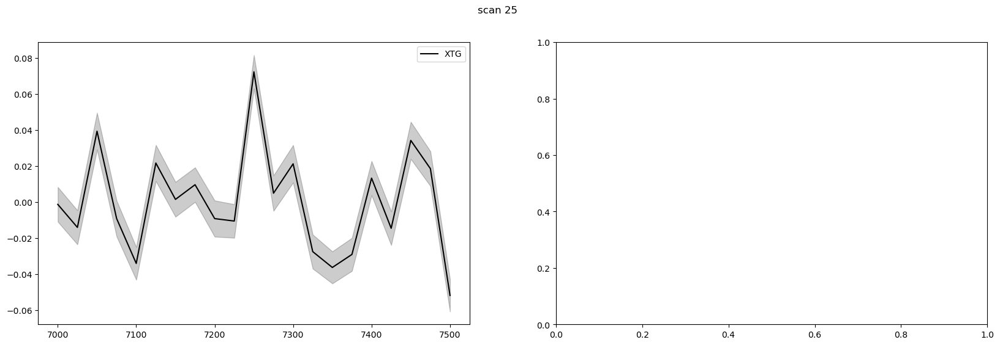

In [61]:
data = np.genfromtxt('Archive_Svetina/Tracce_AXTG_SACLA/Scan_30.txt', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
xtg_25 = extract3(data)

fft_ = fft(xtg_25[1]);   N = len(fft_); timestep = abs(xtg_25[0][1]-xtg_25[0][0])

fft_freq_xtg_25 = fftfreq(N, d=timestep)[:N//2];
fft_xtg_25 = abs(2/N*(fft_[:N//2]))

# print(timestep)
            
# data = np.genfromtxt('Archive_Svetina/S25_i10_EXP.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
# sim_25 = extract(data)

# fft_ = fft(sim_25[1]);   N = len(fft_); timestep = abs(sim_25[0][1]-sim_25[0][0])

# fft_freq_sim_25 = fftfreq(N, d=timestep)[:N//2];
# fft_sim_25 = abs(2/N*(fft_[:N//2]))

# print(timestep)

fig = plt.figure(figsize=(20, 6)); fig.suptitle('scan 25')
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);
    
ax1.plot(xtg_25[0],xtg_25[1],c='k',label='XTG');
ax1.fill_between(xtg_25[0],xtg_25[1]-xtg_25[2],xtg_25[1]+xtg_25[2],color='k',alpha=.2);
# ax1.plot(sim_25[0],sim_25[1],c='r',label='sim');
ax1.legend();

# ax2.plot(fft_freq_xtg_25[:],fft_xtg_25[:],c='k',label='FT XTG');
# ax2.plot(fft_freq_sim_25[:],fft_sim_25[:],c='r',label='FT sim');
# ax2.legend();

25.0
10.0


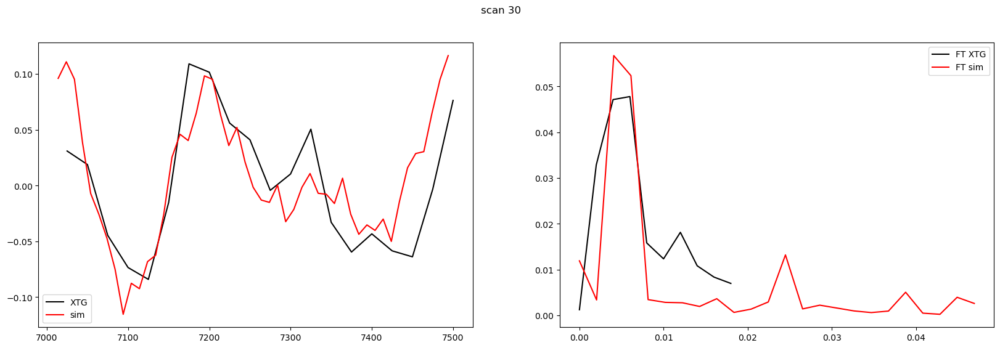

In [69]:
data = np.genfromtxt('Archive_Svetina/S30_avg_EXP.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
xtg_25 = extract2(data)

fft_ = fft(xtg_25[1]);   N = len(fft_); timestep = abs(xtg_25[0][1]-xtg_25[0][0])

fft_freq_xtg_25 = fftfreq(N, d=timestep)[:N//2];
fft_xtg_25 = abs(2/N*(fft_[:N//2]))

print(timestep)
            
data = np.genfromtxt('Archive_Svetina/S30_avg_SIM.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
sim_25 = extract2(data)

fft_ = fft(sim_25[1]);   N = len(fft_); timestep = abs(sim_25[0][1]-sim_25[0][0])

fft_freq_sim_25 = fftfreq(N, d=timestep)[:N//2];
fft_sim_25 = abs(2/N*(fft_[:N//2]))

print(timestep)

fig = plt.figure(figsize=(20, 6)); fig.suptitle('scan 30')
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);
    
ax1.plot(xtg_25[0],xtg_25[1],c='k',label='XTG');
ax1.plot(sim_25[0],sim_25[1],c='r',label='sim');
ax1.legend()

ax2.plot(fft_freq_xtg_25[:],fft_xtg_25[:],c='k',label='FT XTG');
ax2.plot(fft_freq_sim_25[:],fft_sim_25[:],c='r',label='FT sim');
ax2.legend();

#### den

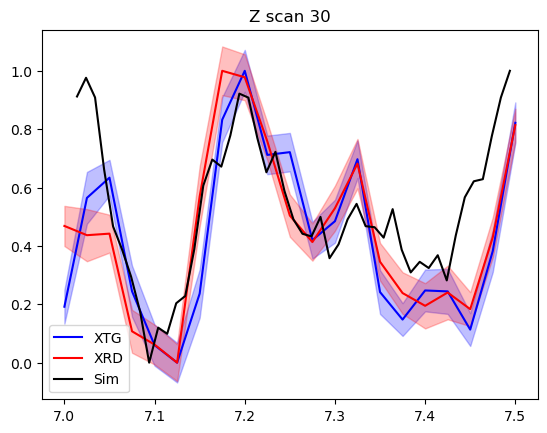

In [190]:
plt.title('Z scan 30');
    
gratings,data_norm,error = np.loadtxt('Scan_30_XTG_[96,40].txt', skiprows=0).T
plt.plot(gratings, NormalizeData(data_norm), c='b', label='XTG')
norm = np.max(data_norm-np.min(data_norm))
plt.fill_between(gratings, NormalizeData(data_norm)-error/norm,NormalizeData(data_norm)+error/norm, color='b', alpha=0.25)
          
gratings,data_norm,error = np.loadtxt('Scan_30_XRD_[11,42].txt', skiprows=0).T
plt.plot(gratings, NormalizeData(data_norm), c='r', label='XRD')
norm = np.max(data_norm-np.min(data_norm))
plt.fill_between(gratings, NormalizeData(data_norm)-error/norm,NormalizeData(data_norm)+error/norm, color='r', alpha=0.25)
          
data = np.genfromtxt('Archive_Svetina/S30_avg_SIM.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
sim_x,sim_y = extract2(data)
plt.plot(sim_x/1000, NormalizeData(sim_y), color='k', label='Sim');

plt.legend();

### 33

25.0
26.002166999999645


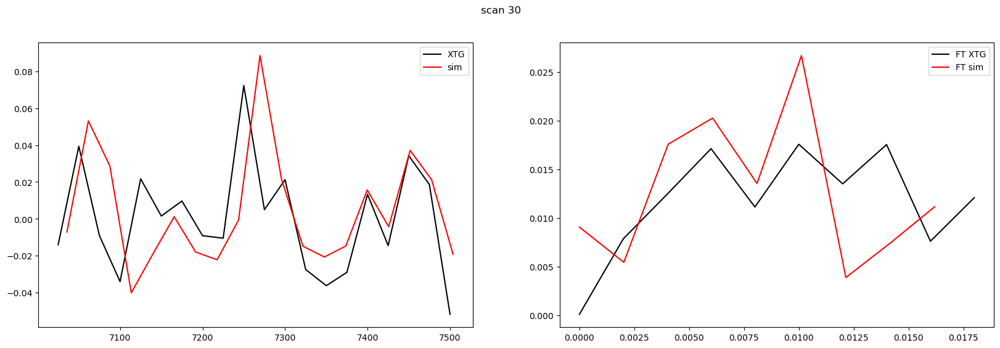

In [352]:
data = np.genfromtxt('Archive_Svetina/S33_avg_EXP.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
xtg_25 = extract(data)

fft_ = fft(xtg_25[1]);   N = len(fft_); timestep = abs(xtg_25[0][1]-xtg_25[0][0])

fft_freq_xtg_25 = fftfreq(N, d=timestep)[:N//2];
fft_xtg_25 = abs(2/N*(fft_[:N//2]))

print(timestep)
            
data = np.genfromtxt('Archive_Svetina/S33_avg_SIM.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
sim_25 = extract(data)

fft_ = fft(sim_25[1]);   N = len(fft_); timestep = abs(sim_25[0][1]-sim_25[0][0])

fft_freq_sim_25 = fftfreq(N, d=timestep)[:N//2];
fft_sim_25 = abs(2/N*(fft_[:N//2]))

print(timestep)

fig = plt.figure(figsize=(20, 6)); fig.suptitle('scan 33')
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);
    
ax1.plot(xtg_25[0],xtg_25[1],c='k',label='XTG');
ax1.plot(sim_25[0],sim_25[1],c='r',label='sim');
ax1.legend()

ax2.plot(fft_freq_xtg_25[:],fft_xtg_25[:],c='k',label='FT XTG');
ax2.plot(fft_freq_sim_25[:],fft_sim_25[:],c='r',label='FT sim');
ax2.legend();

### 36

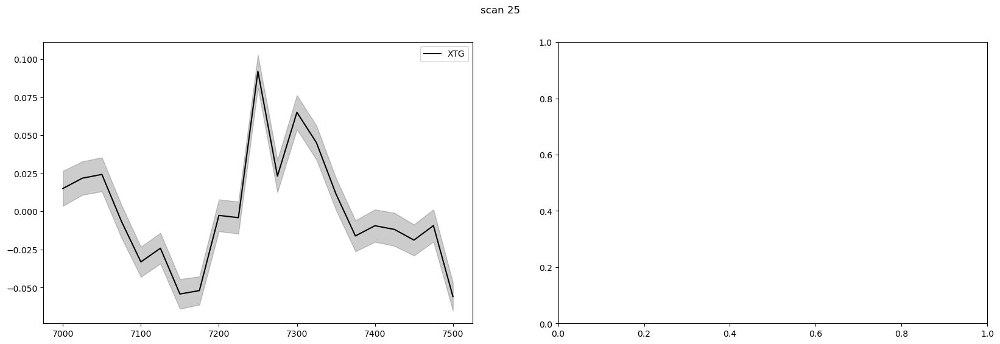

In [65]:
data = np.genfromtxt('Archive_Svetina/Tracce_AXTG_SACLA/Scan_36.txt', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
xtg_25 = extract3(data)

fft_ = fft(xtg_25[1]);   N = len(fft_); timestep = abs(xtg_25[0][1]-xtg_25[0][0])

fft_freq_xtg_25 = fftfreq(N, d=timestep)[:N//2];
fft_xtg_25 = abs(2/N*(fft_[:N//2]))

# print(timestep)
            
# data = np.genfromtxt('Archive_Svetina/S25_i10_EXP.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
# sim_25 = extract(data)

# fft_ = fft(sim_25[1]);   N = len(fft_); timestep = abs(sim_25[0][1]-sim_25[0][0])

# fft_freq_sim_25 = fftfreq(N, d=timestep)[:N//2];
# fft_sim_25 = abs(2/N*(fft_[:N//2]))

# print(timestep)

fig = plt.figure(figsize=(20, 6)); fig.suptitle('scan 25')
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);
    
ax1.plot(xtg_25[0],xtg_25[1],c='k',label='XTG');
ax1.fill_between(xtg_25[0],xtg_25[1]-xtg_25[2],xtg_25[1]+xtg_25[2],color='k',alpha=.2);
# ax1.plot(sim_25[0],sim_25[1],c='r',label='sim');
ax1.legend();

# ax2.plot(fft_freq_xtg_25[:],fft_xtg_25[:],c='k',label='FT XTG');
# ax2.plot(fft_freq_sim_25[:],fft_sim_25[:],c='r',label='FT sim');
# ax2.legend();

25.0
10.0


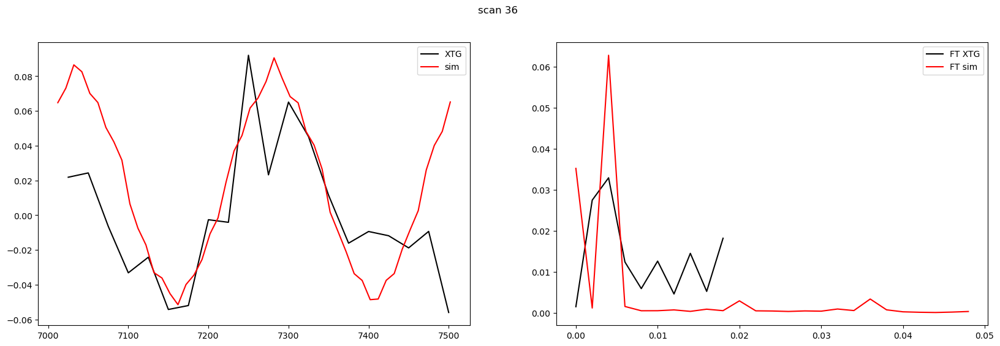

In [67]:
data = np.genfromtxt('Archive_Svetina/S36_avg_EXP.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
xtg_25 = extract(data)

fft_ = fft(xtg_25[1]);   N = len(fft_); timestep = abs(xtg_25[0][1]-xtg_25[0][0])

fft_freq_xtg_25 = fftfreq(N, d=timestep)[:N//2];
fft_xtg_25 = abs(2/N*(fft_[:N//2]))

print(timestep)
            
data = np.genfromtxt('Archive_Svetina/S36_avg_SIM.dat', skip_header=0, skip_footer=0, names=True, dtype=None, delimiter='')
sim_25 = extract(data)

fft_ = fft(sim_25[1]);   N = len(fft_); timestep = abs(sim_25[0][1]-sim_25[0][0])

fft_freq_sim_25 = fftfreq(N, d=timestep)[:N//2];
fft_sim_25 = abs(2/N*(fft_[:N//2]))

print(timestep)

fig = plt.figure(figsize=(20, 6)); fig.suptitle('scan 36')
ax1 = fig.add_subplot(121); ax2 = fig.add_subplot(122);
    
ax1.plot(xtg_25[0],xtg_25[1],c='k',label='XTG');
ax1.plot(sim_25[0],sim_25[1],c='r',label='sim');
ax1.legend()

ax2.plot(fft_freq_xtg_25[:],fft_xtg_25[:],c='k',label='FT XTG');
ax2.plot(fft_freq_sim_25[:],fft_sim_25[:],c='r',label='FT sim');
ax2.legend();

In [ ]:
>